# Opdracht voor numerieke analyse

Idee:
- deeltje dat beweegt, in x-plane.
- botsing met wand, draait v om



In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

In this simulation we want to simulate particles and their 'behavior'. As we want, later on, to create a whole bunch of particles, we have to come up with a clever solution: classes.

A *class* is a blueprint for creating objects (like particles, atoms, planets, cars, students... you name it!). It lets you bundle data (like position, mass) and behavior (like move, collide) into one neat unit. Exactly the thing we need. Let's create the anatomic of a particle.

In [2]:
# Define a class for a particle
class Particle:
    def __init__(self, m, v, r, R):
        self.m = m                  # mass of the particle
        self.v = np.array(v, dtype=float)  # velocity vector
        self.r = np.array(r, dtype=float)  # position vector
        self.R = np.array(R, dtype=float)  # radius of the particle

    def update_position(self, dt):
        """Update the particle's position based on its velocity and time step dt."""
        self.r += self.v * dt

We haven't done much yet but creating the idea of the particle with a mass, velocity, position and radius. We also know that its next position is its current position + the velocity times the timestep $x_{n+1}=x_n + v*dt$. Now let us create the first parts of the simulation:

In [3]:
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[5.0, 0], r=[0.0, 0.0],R=1.0)  

Now we have a particle with a mass, a velocity, a starting position and a radius.

Let start making the plot, as we want to animate the particle:

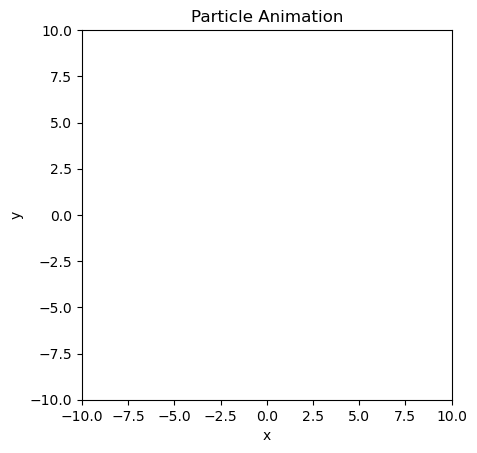

In [4]:
# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10); # semicolon to suppress output

In [5]:
# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_position(dt)
    dot.set_data([particle.r[0]], [particle.r[1]])
    return dot,

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())


Note that if we run the last cell again, the particle is not at its origin. That is a 'quirk' of jupyter notebooks. It is better to now put all code in a single cell so that we make sure that the particle always starts at the origin.

One of the things what you can notice is that the particle doesn't stay in its box. 

**Exercise 1** 
Change the code so that the box is a conitinuous box, flying out at the left means entering at the right (and vice versa).

**Exercise 2**
Improve the code so that the particle will stay in its box.

In [ ]:
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[5.0, 0], r=[0.0, 0.0],R=1.0)  

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10)

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_position(dt)
    dot.set_data([particle.r[0]], [particle.r[1]])
    return dot,

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())


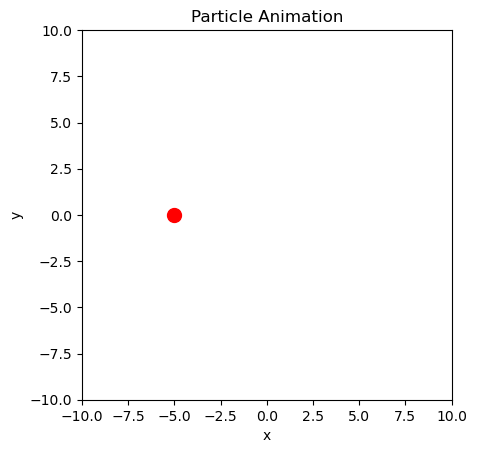

In [6]:
### BEGIN_SOLUTION
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[5.0, 0], r=[0.0, 0.0],R=1.0)  

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10);

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_position(dt)
    dot.set_data([particle.r[0]], [particle.r[1]])
    if particle.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
    #     particle.v[0] = -particle.v[0]
        particle.r[0] = -particle.r[0]
    return dot,

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

Now, change the code so that it has a velocity $\vec{v}=5\hat{x} + 3\hat{y}$ and bounces of the walls.

In [ ]:
### BEGIN_SOLUTION
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[5.0, 3.0], r=[0.0, 0.0],R=1.0)  

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10);

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_position(dt)
    dot.set_data([particle.r[0]], [particle.r[1]])
    if particle.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[0] = -particle.v[0]
    if particle.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[1] = -particle.v[1]
    return dot,

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

Let us get back to our particle. There is a function for updating the position, although the velocity seems to stay the same... can we change the velocity due to (e.g.) the acceleration due to gravity?

In [2]:
# Define a class for a particle
class Particle:
    def __init__(self, m, v, r, R):
        self.m = m                  # mass of the particle
        self.v = np.array(v, dtype=float)  # velocity vector
        self.r = np.array(r, dtype=float)  # position vector
        self.R = np.array(R, dtype=float)  # radius of the particle

    def update_position(self, dt):
        """Update the particle's position based on its velocity and time step dt."""
        self.r += self.v * dt
    
    def update_velocity(self, a, dt):
        """Update the particle's velocity."""
        self.v += a*dt

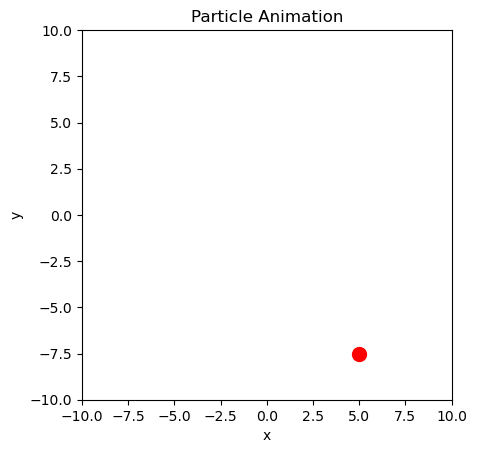

In [3]:
### BEGIN_SOLUTION
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[5.0, 0], r=[0.0, 0.0],R=1.0)  
a = np.array([0.0, -5.0])  

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10);

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_velocity(a, dt)
    particle.update_position(dt)
    
    dot.set_data([particle.r[0]], [particle.r[1]])
    if particle.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[0] = -particle.v[0]
    if particle.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[1] = -particle.v[1]
    return dot,

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

Note no energy conservation!
dt smaller is an option. 2nd option is more direct, if $a = const$.

Also, can we track where the particle has been?

In [ ]:
### BEGIN_SOLUTION
# Define a class for a particle
class Particle:
    def __init__(self, m, v, r, R):
        self.m = m                  # mass of the particle
        self.v = np.array(v, dtype=float)  # velocity vector
        self.r = np.array(r, dtype=float)  # position vector
        self.R = np.array(R, dtype=float)  # radius of the particle

    def update_position(self, dt):
        """Update the particle's position based on its velocity and time step dt."""
        self.r += self.v * dt + 1/2 * a * dt**2  # Update position with acceleration term
    
    def update_velocity(self, a, dt):
        """Update the particle's velocity."""
        self.v += a*dt

# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particle = Particle(m=1.0, v=[0, 0], r=[0.0, 0.0],R=1.0)  
a = np.array([0.0, -5.0])  

track_x = []
track_y = []

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")
track_line, = ax.plot([], [], 'r--', linewidth=1)  

# Create the particle as a red dot
dot, = ax.plot([], [], 'ro', markersize=10);

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particle.update_position(dt)
    particle.update_velocity(a, dt)

    track_x.append(particle.r[0])
    track_y.append(particle.r[1])
    track_line.set_data(track_x, track_y)
    
    dot.set_data([particle.r[0]], [particle.r[1]])
    if particle.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[0] = -particle.v[0]
    if particle.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particle.v[1] = -particle.v[1]
    return dot, track_line

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

Now two particles, particle A and particle B

AttributeError: 'Particle' object has no attribute 'update_velocity'

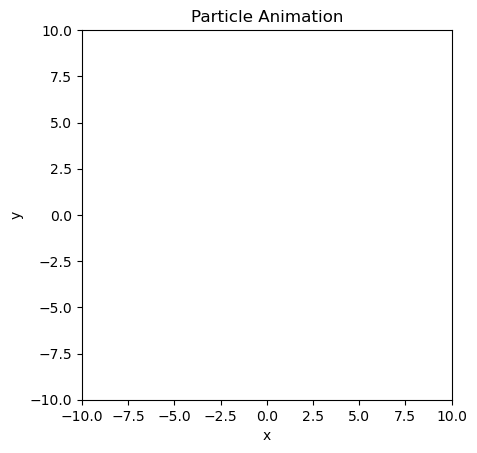

In [6]:
### BEGIN_SOLUTION
# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps
particleA = Particle(m=1.0, v=[0, 0], r=[0.0, 0.0],R=1.0)  
particleB = Particle(m=1.0, v=[5.0, 0], r=[0.0, 0.0],R=1.0)

a = np.array([0.0, -5.0])  

track_x = []
track_y = []

# Create the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")
track_line, = ax.plot([], [], 'r--', linewidth=1)  

# Create the particle as a red dot
dotA, = ax.plot([], [], 'ro', markersize=10)
dotB, = ax.plot([], [], 'bo', markersize=10)

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particleA.update_position(dt)
    particleA.update_velocity(a, dt)

    particleB.update_position(dt)
    particleB.update_velocity(a, dt)

    track_x.append(particleA.r[0])
    track_y.append(particleA.r[1])
    track_line.set_data(track_x, track_y)
    
    dotA.set_data([particleA.r[0]], [particleA.r[1]])
    dotB.set_data([particleB.r[0]], [particleB.r[1]])

    if particleA.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleA.v[0] = -particleA.v[0]
    if particleA.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleA.v[1] = -particleA.v[1]

    if particleB.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[0] = -particleB.v[0]
    if particleB.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[1] = -particleB.v[1]

    return dot, track_line

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

No let's try to build a 1D collider.

detection, change v when colliding.

also change R

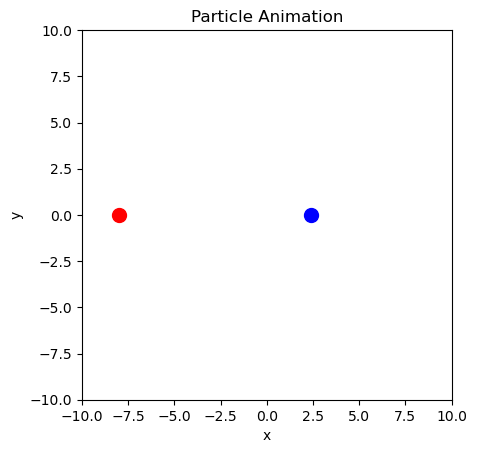

In [7]:
### BEGIN_SOLUTION
# Define a class for a particle
class Particle:
    def __init__(self, m, v, r, R):
        self.m = m                  # mass of the particle
        self.v = np.array(v, dtype=float)  # velocity vector
        self.r = np.array(r, dtype=float)  # position vector
        self.R = np.array(R, dtype=float)  # radius of the particle

    def update_position(self, dt):
        """Update the particle's position based on its velocity and time step dt."""
        self.r += self.v * dt 

    def collide_detection(self, other):
        """Check for collision with another particle."""
        return np.linalg.norm(self.r - other.r) < (self.R + other.R)

# Simulation parameters
dt = 0.1         # time step
num_steps = 500  # number of time steps

particleA = Particle(m=1.0, v=[2.5, 0], r=[-2.0, 0.0],R=0.45)  
particleB = Particle(m=1.0, v=[-1, 0], r=[0.0, 0.0],R=0.45)  

# Create the figure and axis

fig, ax = plt.subplots()

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")


# Create the particle as a red dot
dotA, = ax.plot([], [], 'ro', markersize=10)
dotB, = ax.plot([], [], 'bo', markersize=10)

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    particleA.update_position(dt)
    particleB.update_position(dt)

    track_x.append(particleA.r[0])
    track_y.append(particleA.r[1])
    track_line.set_data(track_x, track_y)
    
    dotA.set_data([particleA.r[0]], [particleA.r[1]])
    dotB.set_data([particleB.r[0]], [particleB.r[1]])

    #collision detection and response
    if particleA.collide_detection(particleB):
        particleA.v[0] = -particleA.v[0]
        particleB.v[0] = -particleB.v[0]

    # wall collision detection and response
    if particleA.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleA.v[0] = -particleA.v[0]
    if particleA.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleA.v[1] = -particleA.v[1]

    dot.set_data([particleB.r[0]], [particleB.r[1]])
    if particleB.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[0] = -particleB.v[0]
    if particleB.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[1] = -particleB.v[1]

    return dot, track_line

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION

now with collission formula
know.. in updating, vb relies on va, so use hulpvariabele

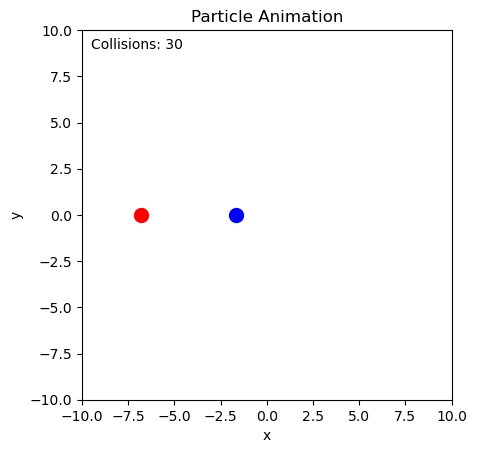

In [8]:
### BEGIN_SOLUTION
# Define a class for a particle
class Particle:
    def __init__(self, m, v, r, R):
        self.m = m                  # mass of the particle
        self.v = np.array(v, dtype=float)  # velocity vector
        self.r = np.array(r, dtype=float)  # position vector
        self.R = np.array(R, dtype=float)  # radius of the particle

    def update_position(self, dt):
        """Update the particle's position based on its velocity and time step dt."""
        self.r += self.v * dt 

    def collide_detection(self, other):
        """Check for collision with another particle."""
        return np.linalg.norm(self.r - other.r) <= (self.R + other.R)

# Simulation parameters
dt = 0.1         # time step
num_steps = 530  # number of time steps

particleA = Particle(m=1.0, v=[0, 0], r=[-2.0, 0.0],R=0.45)  
particleB = Particle(m=100.0, v=[-1, 0], r=[2.0, 0.0],R=0.45)  

# Create the figure and axis

fig, ax = plt.subplots()

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_aspect('equal')
ax.set_title("Particle Animation")
ax.set_xlabel("x")
ax.set_ylabel("y")

counter = 0

# Create the particle as a red dot
dotA, = ax.plot([], [], 'ro', markersize=10)
dotB, = ax.plot([], [], 'bo', markersize=10)

counter_text = ax.text(-9.5, 9, "")

# Initialization function for animation
def init():
    dot.set_data([], [])
    return dot,

# Update function for each frame
def update(frame):
    global counter
    particleA.update_position(dt)
    particleB.update_position(dt)

    track_x.append(particleA.r[0])
    track_y.append(particleA.r[1])
    track_line.set_data(track_x, track_y)
    
    dotA.set_data([particleA.r[0]], [particleA.r[1]])
    dotB.set_data([particleB.r[0]], [particleB.r[1]])

    counter_text.set_text(f"Collisions: {counter}")

    #collision detection and response
    if particleA.collide_detection(particleB):
        counter += 1
        vA, vB, mA, mB, rA, rB = particleA.v, particleB.v, particleA.m, particleB.m, particleA.r, particleB.r
        vA_new = vA - 2 * mB / (mA + mB) * np.dot(vA - vB, rA - rB) / (1e-12+np.linalg.norm(rA - rB))**2 * (rA - rB)
        vB_new = vB - 2 * mA / (mA + mB) * np.dot(vB - vA, rB - rA) / (1e-12+np.linalg.norm(rB - rA))**2 * (rB - rA)
        particleA.v = vA_new
        particleB.v = vB_new


    # wall collision detection and response
    if particleA.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        counter += 1
        particleA.v[0] = -particleA.v[0]
    if particleA.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleA.v[1] = -particleA.v[1]

    dot.set_data([particleB.r[0]], [particleB.r[1]])
    if particleB.r[0]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[0] = -particleB.v[0]
    if particleB.r[1]**2>100: # Check if particle is outside the bounds, np.abs could be used but is slower
        particleB.v[1] = -particleB.v[1]

    return dot, track_line, counter_text

# Create animation
ani = FuncAnimation(fig, update, frames=range(200), init_func=init, blit=True, interval=50)

# For Jupyter notebook:
from IPython.display import HTML
HTML(ani.to_jshtml())
### END_SOLUTION
